In [1]:
import numpy as np
import anndata as ad
import scanpy as sc
import scvelo as scv
import sys
import torch
from sklearn.decomposition import PCA
import umap
import os.path
sys.path.append('../')
import velovae as vv
from datetime import datetime

In [2]:
torch.cuda.is_available()

True

In [3]:
now = datetime.now()
date = now.strftime("%m_%d_%Y")

In [4]:
adata = sc.read_h5ad('../../RNA_ATAC/macrophage/3423-MV-2-8489-MV-1-GSM5460410_adata_postpro_concat.h5ad')
adata_atac = sc.read_h5ad('../../RNA_ATAC/macrophage/3423-MV-2-8489-MV-1-GSM5460410_adata_atac_postpro_concat.h5ad')

In [5]:
gene_plot = ['AZU1', 'HBB', 'HDC', 'LYZ', 'PF4', 'SPINK2']
np.isin(gene_plot, adata.var_names)

array([ True,  True,  True,  True,  True,  True])

In [6]:
'PROM1' in adata.var_names

True

In [7]:
dataset = "3423-MV-2-8489-MV-1-GSM5460410"
model_path_base = f"checkpoints/{dataset}"
figure_path_base = f"figures/{dataset}"
data_path_base = f"data/{dataset}"

In [8]:
adata, adata_atac

(AnnData object with n_obs × n_vars = 27841 × 1044
     obs: 'total_unspliced', 'total_spliced', 'log1p_total_unspliced', 'log1p_total_spliced', 'fraction_u', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_rb', 'log1p_total_counts_rb', 'pct_counts_rb', 'total_counts_hla', 'log1p_total_counts_hla', 'pct_counts_hla', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'outlier', 'initial_size_unspliced', 'initial_size_spliced', 'initial_size', 'n_counts', 'S_score', 'G2M_score', 'phase', 'CC_difference', 'total_unspliced2', 'total_spliced2', 'log1p_total_unspliced2', 'log1p_total_spliced2', 'fraction_u2', 'n_c', 'n_Mu', 'n_Ms', 'leiden', 'total_chromatin', 'total_unspliced3', 'total_spliced3', 'log1p_total_unspliced3', 'log1p_total_spliced3', 'fraction_u3', 'total_Mc', 'total_Mu', 'total_Ms', 'batch', 'n_Mc'
     var: 'gene_ids', 'featur

In [9]:
adata.obs['leiden'].cat.categories

Index(['CMP', 'DC', 'Erythrocyte', 'GMP', 'Granulocyte', 'HSC', 'LMPP', 'MEP',
       'Mast Cells', 'Megakaryocyte', 'Platelet', 'Prog B', 'Prog DC',
       'Prog MK'],
      dtype='object')

In [10]:
adata.obs['batch'].cat.categories

Index(['Multiome 1', 'Multiome 2', 'scRNA'], dtype='object')

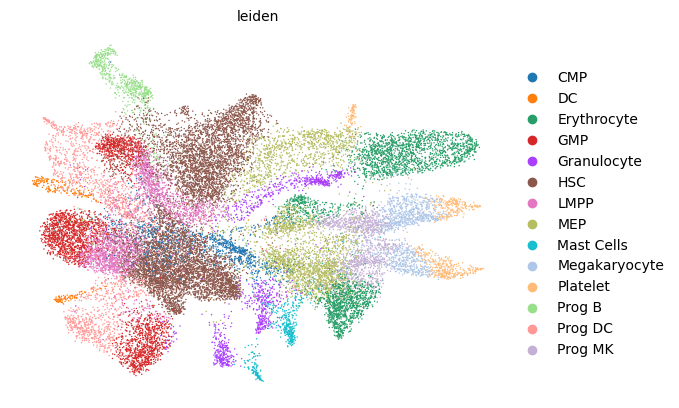

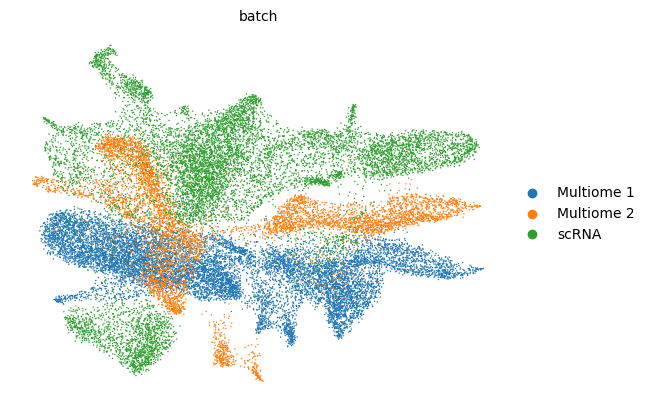

In [11]:
os.makedirs(figure_path_base, exist_ok=True)
scv.pl.scatter(adata, basis='umap', color='leiden', legend_loc='right margin')
scv.pl.scatter(adata, basis='umap', color='batch', legend_loc='right margin')

In [12]:
figure_path = figure_path_base+'/'+date
model_path = model_path_base+'/'+date
data_path = data_path_base

In [13]:
torch.manual_seed(2022)
np.random.seed(2022)
model = vv.VAEChrom(adata,
                    adata_atac,
                    batch_key='batch',
                    ref_batch=1,
                    batch_hvg_key='highly_variable',
                    var_to_regress=['total_unspliced3'],
                    device='cuda:0',
                    rna_only_idx=2,
                    plot_init=False,
                    gene_plot=gene_plot,
                    cluster_key="leiden",
                    figure_path=figure_path,
                    embed="umap")

model.train(plot=False,
            gene_plot=gene_plot,
            figure_path=figure_path,
            embed="umap")

model.save_model(model_path)
model.save_anndata(data_path, file_name="out.h5ad")

Running in mixed RNA-only mode.
CVAE enabled. Performing batch effect correction.


Reference batch set to 1 (Multiome 2).
Latent dimension set to 9.
KL weights set to 4.00 4.00.
Found ['total_unspliced3'] in obs. Regressing them out.
Batch 0 sparsity: 0.095
Batch 1 sparsity: 0.108
Batch 2 sparsity: 0.169
Learning rate set to 7.5e-4 based on data sparsity.
Early stop threshold set to 2.6.
Using Gaussian Prior.
Initializing using the steady-state and dynamical models.


  0%|          | 0/1044 [00:00<?, ?it/s]

956 out of 1044 = 91.6% genes have good ellipse fits.
KS-test result: [1. 1. 1. 1. 1. 1. 1.]
Assigning cluster 5 to repressive.
Initial induction: 809, repression: 235 out of 1044.
Computing scaling factors for each batch class.
--------------------------- Train a VeloVAE ---------------------------
*********      Creating Training and Validation Datasets      *********
Total Number of Iterations Per Epoch: 77, test iteration: 152
*********                      Finished.                      *********
*********                      Stage  1                       *********
Epoch 1: Train ELBO = 119.073, Test ELBO = -778723.808		Total Time =   0 h :  0 m :  1 s
Epoch 50: Train ELBO = 1407.613, Test ELBO = 1407.692		Total Time =   0 h :  0 m : 32 s
Epoch 100: Train ELBO = 1428.686, Test ELBO = 1423.719		Total Time =   0 h :  1 m :  3 s
*********     Stage 1: Early Stop Triggered at epoch 121.     *********
*********     Retrieving best model from iteration 9121.      *********
*********  

  0%|          | 0/27841 [00:00<?, ?it/s]

Percentage of Invalid Sets: 0.000
Average Set Size: 100
Finished. Actual Time:   0 h :  0 m : 26 s
*********             Velocity Refinement Round 1             *********
Epoch 127: Train ELBO = 1305.002, Test ELBO = 1308.716		Total Time =   0 h :  1 m : 47 s
*********     Round 1: Early Stop Triggered at epoch 127.     *********
*********     Retrieving best model from iteration 9702.      *********
Cell-wise KNN estimation.
Finished. Actual Time:   0 h :  0 m :  3 s
*********             Velocity Refinement Round 2             *********
Epoch 131: Train ELBO = 1273.187, Test ELBO = 1277.815		Total Time =   0 h :  1 m : 54 s
*********     Round 2: Early Stop Triggered at epoch 131.     *********
*********     Retrieving best model from iteration 10002.      *********
Change in x0: 0.210
Cell-wise KNN estimation.
Finished. Actual Time:   0 h :  0 m :  3 s
*********             Velocity Refinement Round 3             *********
Epoch 135: Train ELBO = 1243.057, Test ELBO = 1247.244		Tota

In [14]:
key = "vae"
basis = "umap"

In [15]:
z = adata.obsm[f'{key}_z']
t = adata.obs[f'{key}_time'].to_numpy()
rho = adata.layers[f'{key}_rho']
kc = adata.layers[f'{key}_kc']

In [16]:
umap_obj = umap.UMAP(n_neighbors=30, n_components=2, min_dist=0.25, random_state=2022)
z_umap = umap_obj.fit_transform(z)

z_batch = adata.obsm[f'{key}_z_batch']
umap_obj = umap.UMAP(n_neighbors=30, n_components=2, min_dist=0.25, random_state=2022)
z_umap2 = umap_obj.fit_transform(z_batch)

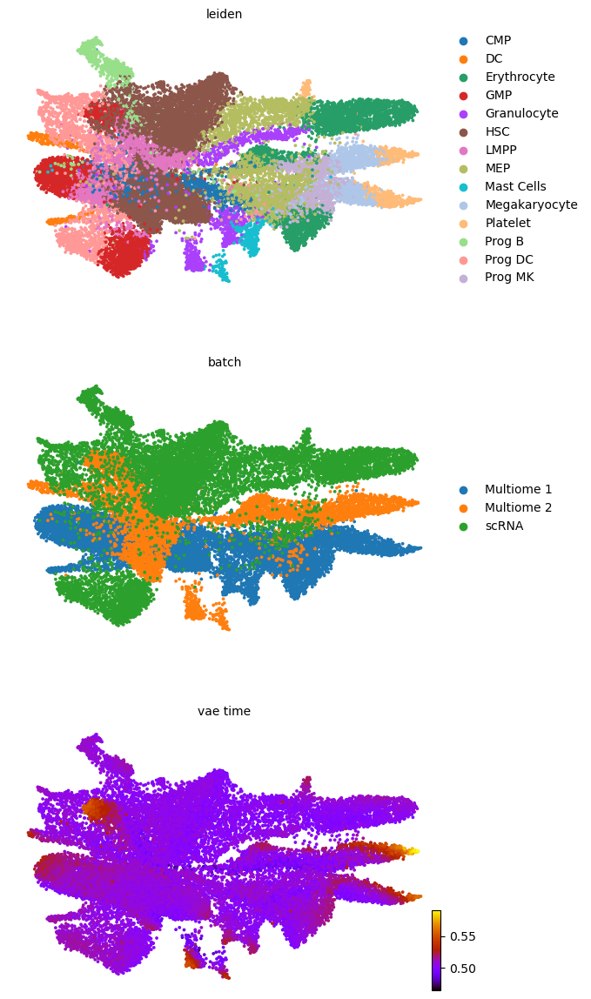

saving figure to file figures/3423-MV-2-8489-MV-1-GSM5460410/11_11_2024/3423-MV-2-8489-MV-1-GSM5460410_z_batch_time_vae.png


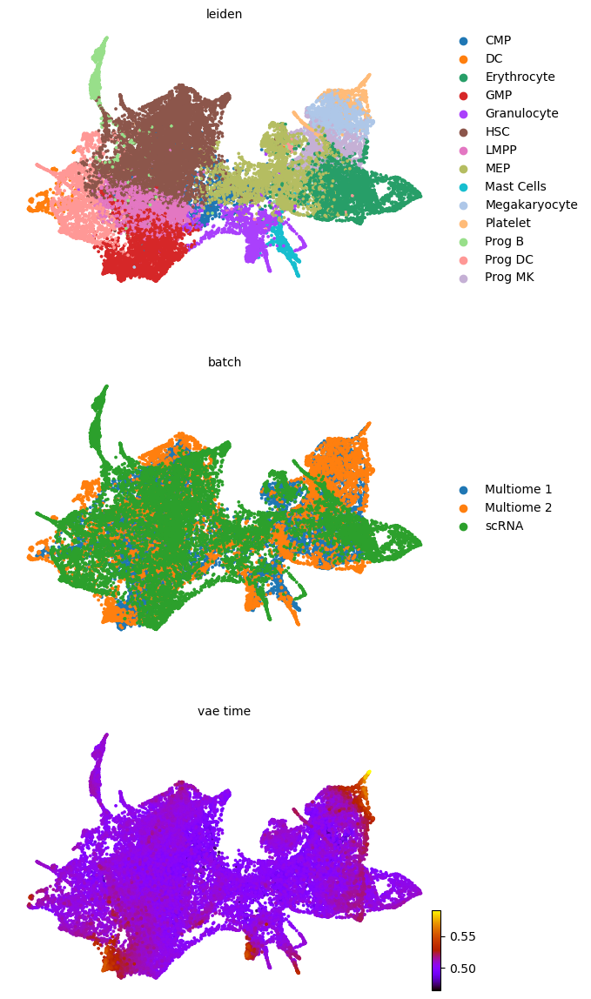

saving figure to file figures/3423-MV-2-8489-MV-1-GSM5460410/11_11_2024/3423-MV-2-8489-MV-1-GSM5460410_z_batch_time2_vae.png


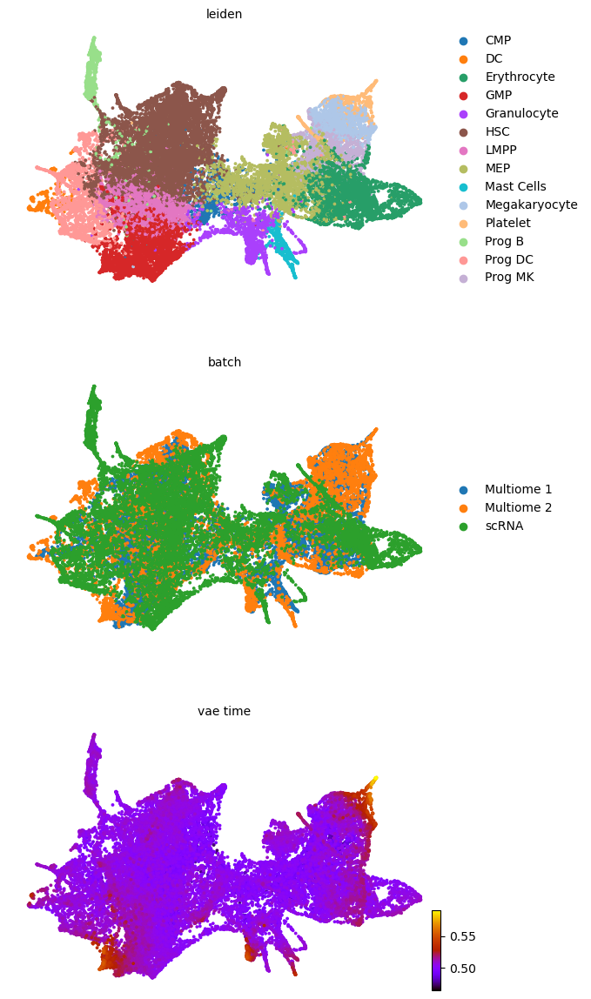

In [17]:
scv.pl.scatter(adata, basis='umap', color=['leiden', 'batch', f'{key}_time'], legend_loc='right', color_map='gnuplot', ncols=1, size=30)
adata.obsm['X_z_umap'] = z_umap
scv.pl.scatter(adata, basis='z_umap', color=['leiden', 'batch', f'{key}_time'], legend_loc='right', color_map='gnuplot', ncols=1, size=30, save=f'{figure_path}/{dataset}_z_batch_time_{key}.png')
adata.obsm['X_z_umap2'] = z_umap2
scv.pl.scatter(adata, basis='z_umap2', color=['leiden', 'batch', f'{key}_time'], legend_loc='right', color_map='gnuplot', ncols=1, size=30, save=f'{figure_path}/{dataset}_z_batch_time2_{key}.png')

In [18]:
adata.obsm[f'{key}_latent'] = np.concatenate((adata.obsm[f'{key}_z'], adata.obsm[f'{key}_t']), axis=1)
sc.pp.neighbors(adata, use_rep=f'{key}_latent', n_neighbors=50)

computing velocity graph (using 1/8 cores)


  0%|          | 0/27841 [00:00<?, ?cells/s]

    finished (0:01:18) --> added 
    'vae_velocity_norm_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:03) --> added
    'vae_velocity_norm_z_umap', embedded velocity vectors (adata.obsm)


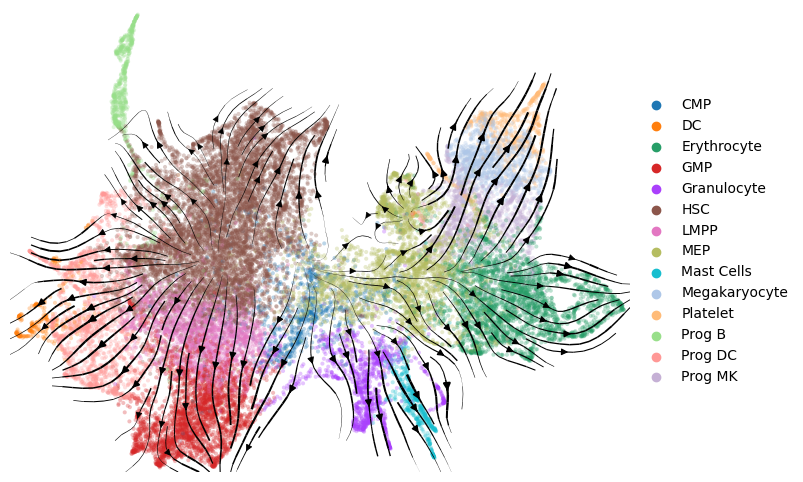

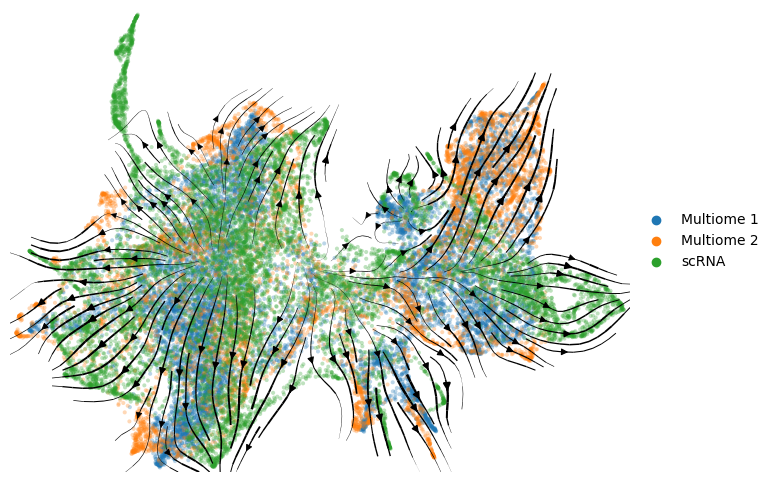

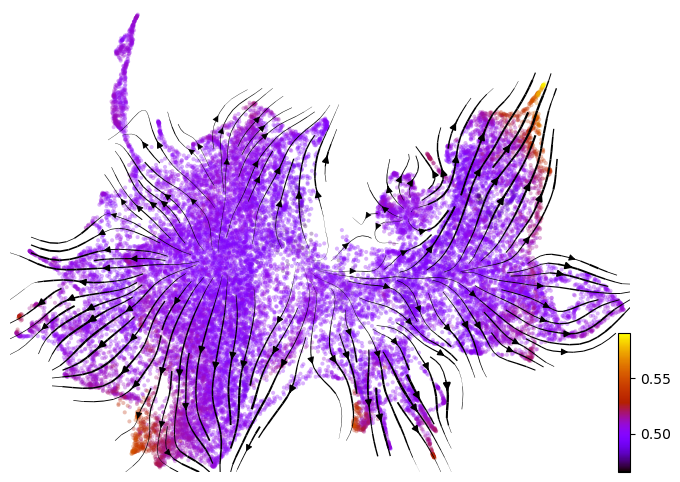

In [19]:
adata.obsm['X_z_umap'] = z_umap
vv.model.velocity_graph(adata, key=key, batch_corrected=True)
vv.velocity_embedding_stream(adata, key=key, basis='z_umap', color='leiden', title="", figsize=(8,6), legend_loc='right margin')
vv.velocity_embedding_stream(adata, key=key, basis='z_umap', color='batch', title="", figsize=(8,6), legend_loc='right margin')
vv.velocity_embedding_stream(adata, key=key, basis='z_umap', color=f'{key}_time', color_map='gnuplot', title="", figsize=(8,6), legend_loc='right margin')

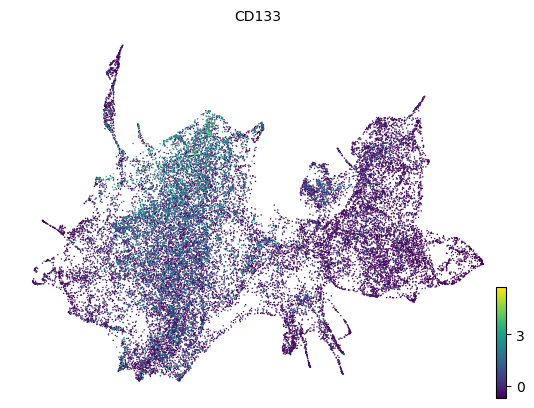

In [20]:
scv.pl.scatter(adata, color='PROM1', basis='z_umap', title='CD133')

In [21]:
adata.obs['clusters'] = adata.obs['leiden']

In [22]:
adata_sub = adata[adata.obs['batch']=='scRNA',:].copy()
adata_atac_sub = adata_atac[adata.obs['batch']=='scRNA',:].copy()

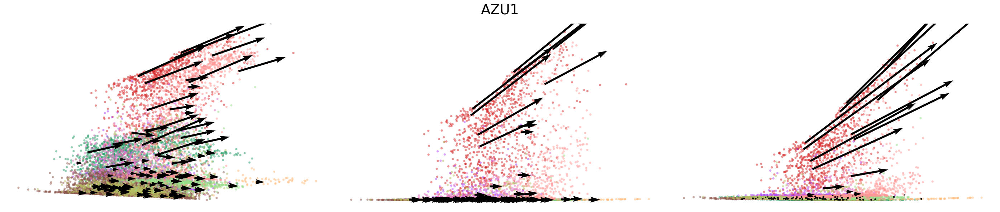

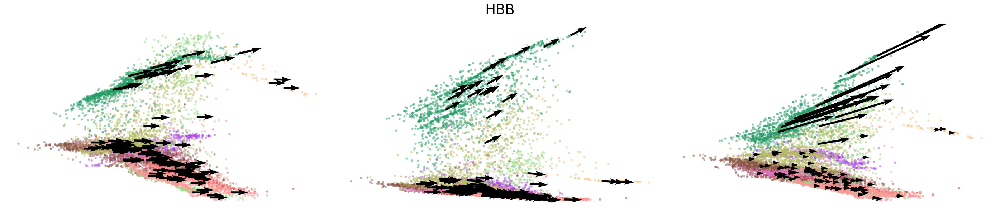

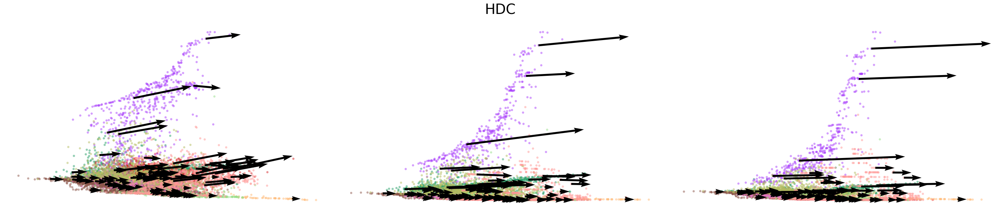

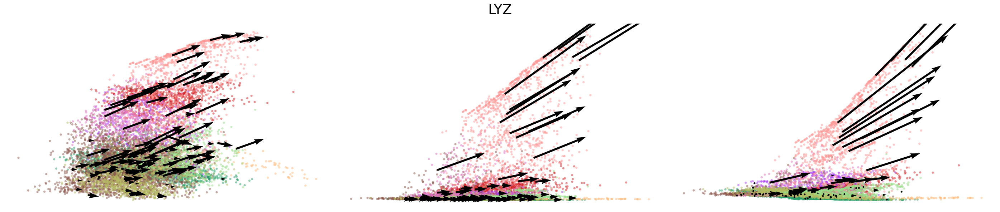

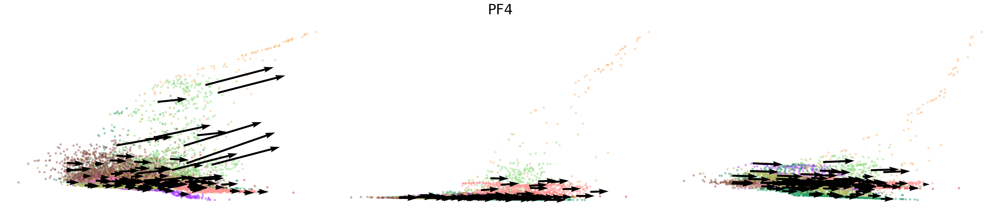

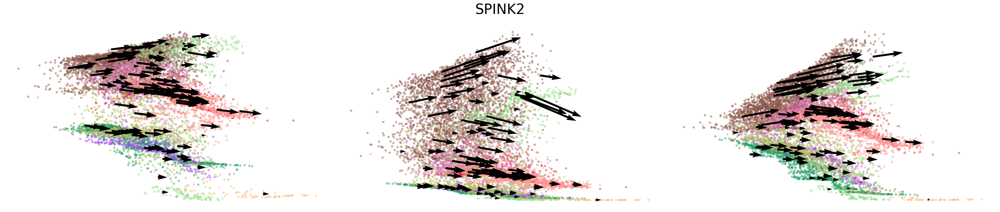

In [23]:
np.random.seed(2022)
for gene in gene_plot:
    vv.plot_vel(adata_sub.obs[f'{key}_time'],
                adata_sub[:,gene].layers[f'{key}_chat'],
                adata_sub[:,gene].layers[f'{key}_uhat'],
                adata_sub[:,gene].layers[f'{key}_shat'],
                adata_sub[:,gene].layers[f'{key}_velocity_c'],
                adata_sub[:,gene].layers[f'{key}_velocity_u'],
                adata_sub[:,gene].layers[f'{key}_velocity'],
                cell_labels=adata_sub.obs['leiden'].to_numpy(),
                cell_type_colors=model.cell_type_colors,
                title=gene,
                frame_on=False,
                axis_on=False,
                legend=False)

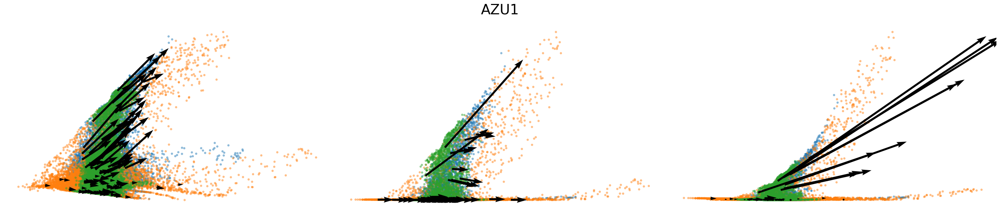

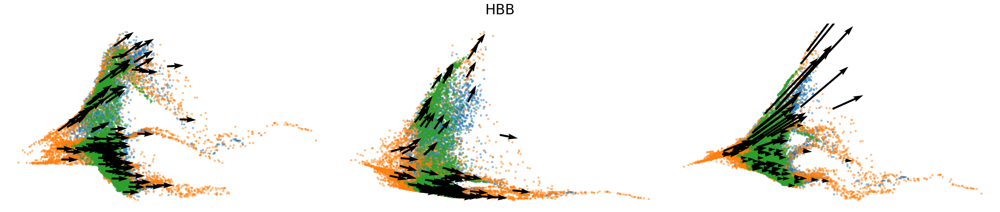

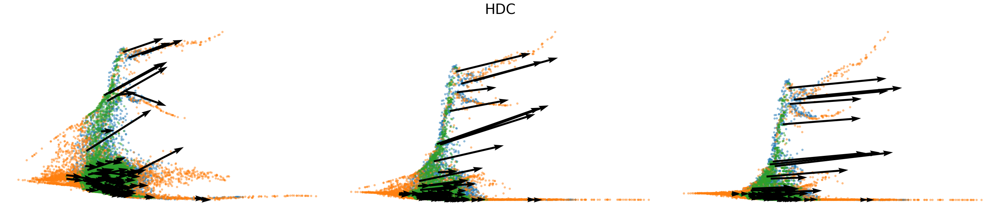

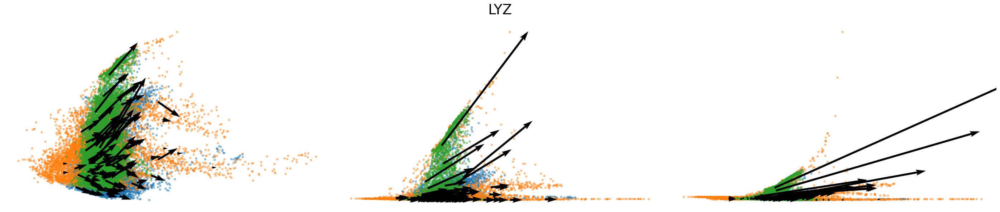

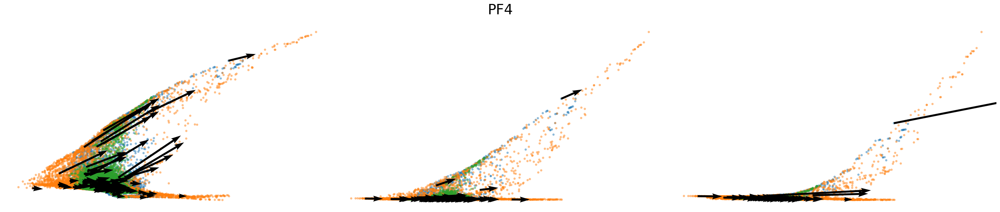

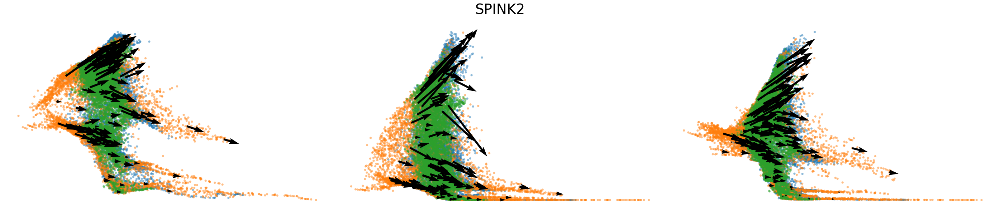

In [24]:
batch_raw = adata.obs['batch'].cat.categories.to_numpy()
batch_colors = {batch_raw[i]: adata.uns['batch_colors'][i] for i in range(len(batch_raw))}
np.random.seed(2022)
for gene in gene_plot:
    vv.plot_vel(adata.obs[f'{key}_time'],
                adata[:,gene].layers[f'{key}_chat'],
                adata[:,gene].layers[f'{key}_uhat'],
                adata[:,gene].layers[f'{key}_shat'],
                adata[:,gene].layers[f'{key}_velocity_c'],
                adata[:,gene].layers[f'{key}_velocity_u'],
                adata[:,gene].layers[f'{key}_velocity'],
                cell_labels=adata.obs['batch'].to_numpy(),
                cell_type_colors=batch_colors,
                title=gene,
                frame_on=False,
                axis_on=False,
                legend=False)

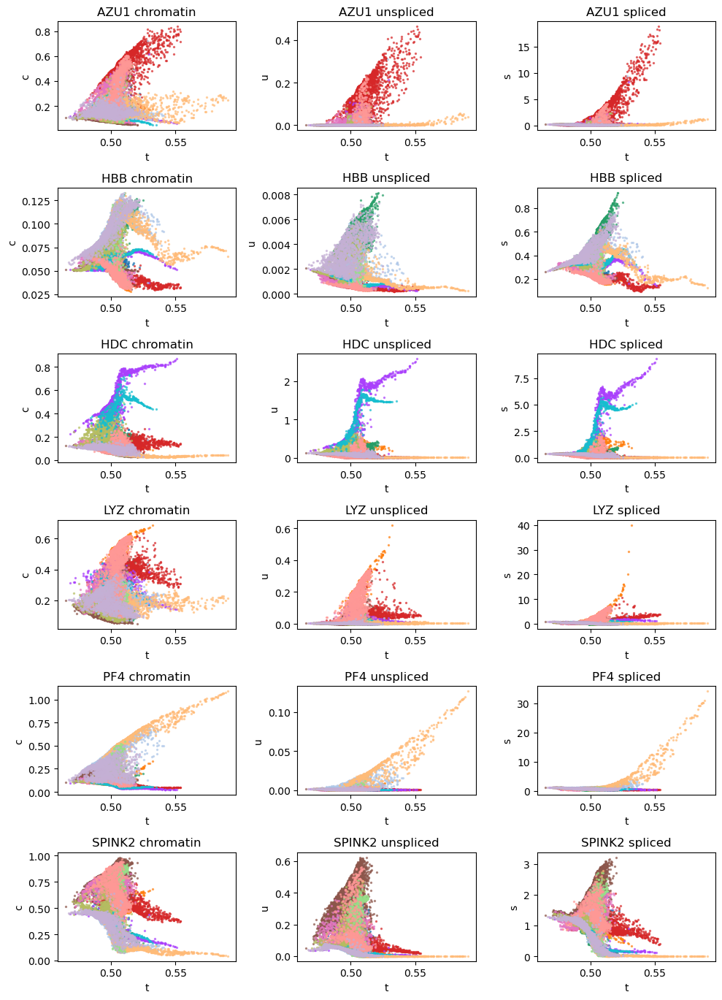

In [25]:
vv.dynamic_plot(adata, adata_atac, gene_plot, color_by='leiden', batch_correction=True)

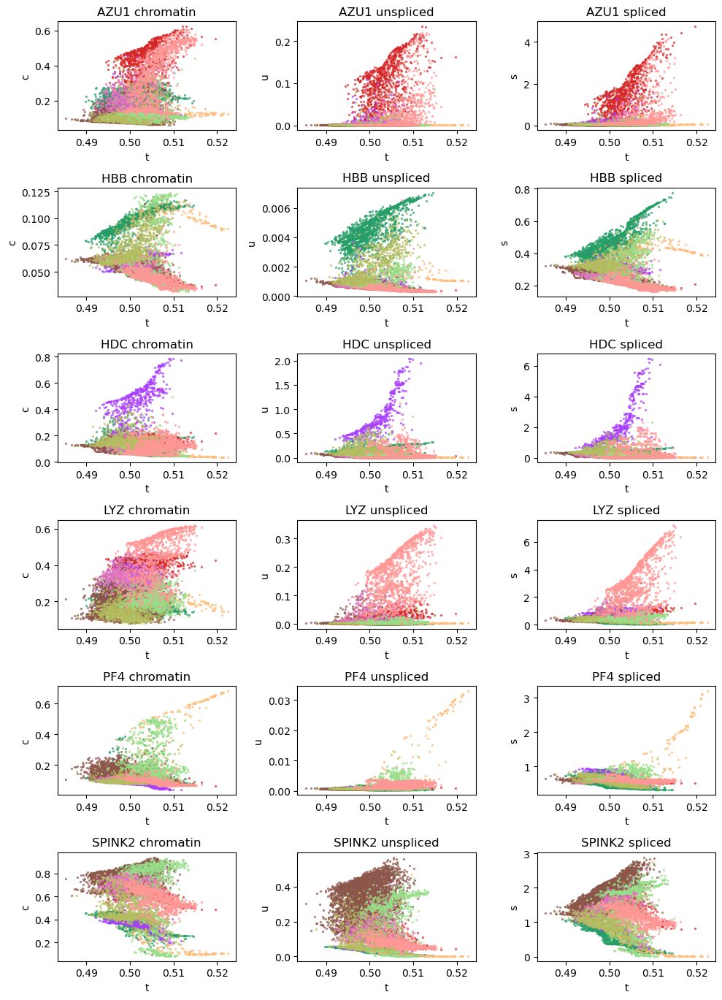

In [26]:
vv.dynamic_plot(adata_sub, adata_atac_sub, gene_plot, color_by='leiden', batch_correction=True)

In [27]:
top_genes = adata[:, adata.var[f'{key}_velocity_genes']].var[f'{key}_likelihood'].sort_values(ascending=False).index

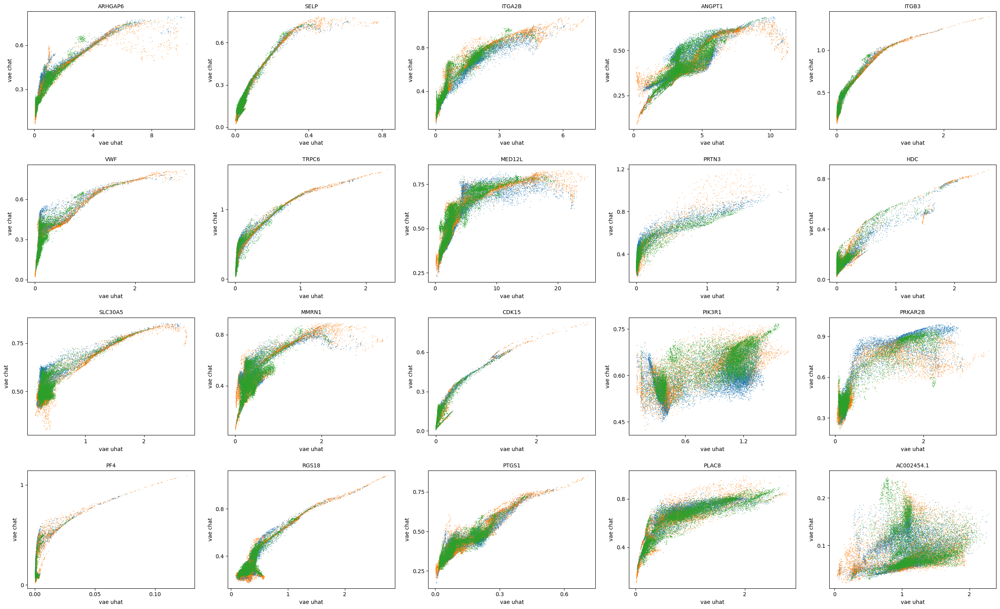

In [28]:
scv.pl.scatter(adata, basis=top_genes[:20], x=f'{key}_uhat', y=f'{key}_chat', color='batch', ncols=5)

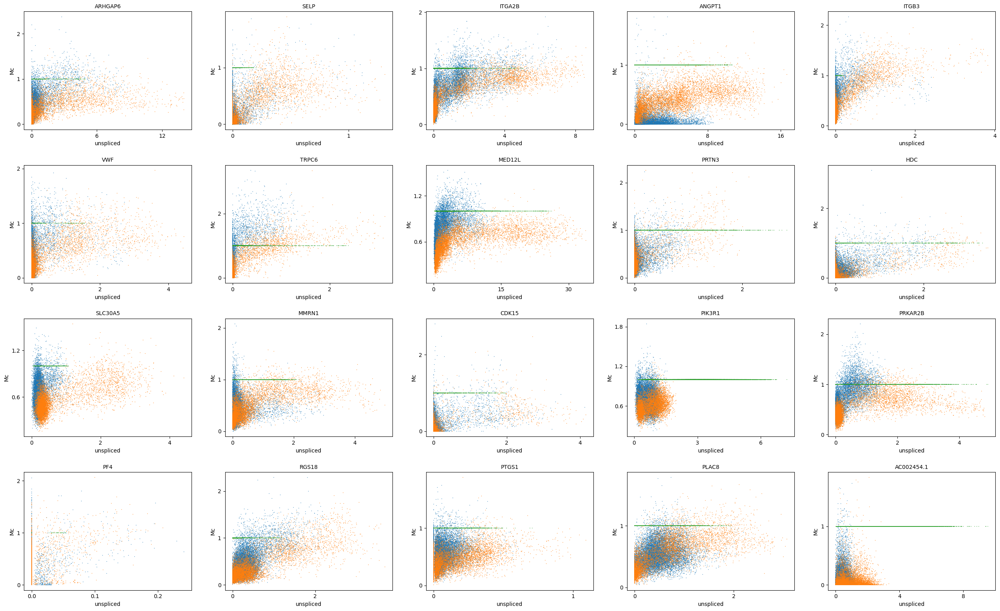

In [29]:
adata.layers['Mc'] = adata_atac.layers['Mc']
scv.pl.scatter(adata, basis=top_genes[:20], x='Mu', y='Mc', color='batch', ncols=5)

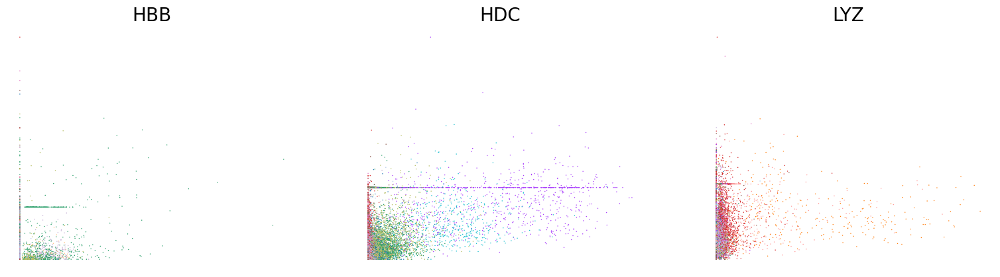

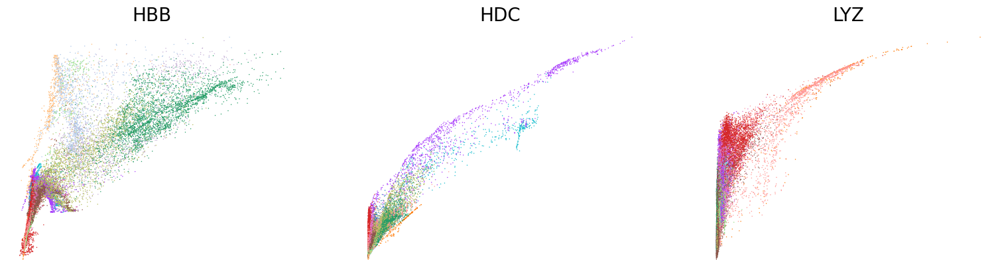

In [30]:
scv.pl.scatter(adata, basis=['HBB', 'HDC', 'LYZ'], x='Mu', y='Mc', color='leiden', ncols=4, frameon=False, fontsize=20)
scv.pl.scatter(adata, basis=['HBB', 'HDC', 'LYZ'], x=f'{key}_uhat', y=f'{key}_chat', color='leiden', ncols=4, frameon=False, fontsize=20)

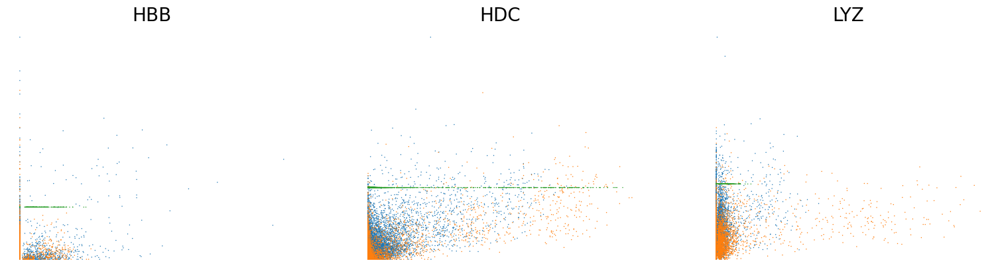

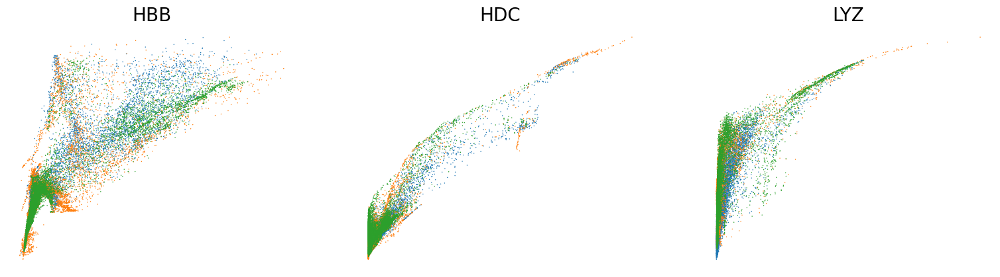

In [31]:
scv.pl.scatter(adata, basis=['HBB', 'HDC', 'LYZ'], x='Mu', y='Mc', color='batch', ncols=4, frameon=False, fontsize=20)
scv.pl.scatter(adata, basis=['HBB', 'HDC', 'LYZ'], x=f'{key}_uhat', y=f'{key}_chat', color='batch', ncols=4, frameon=False, fontsize=20)

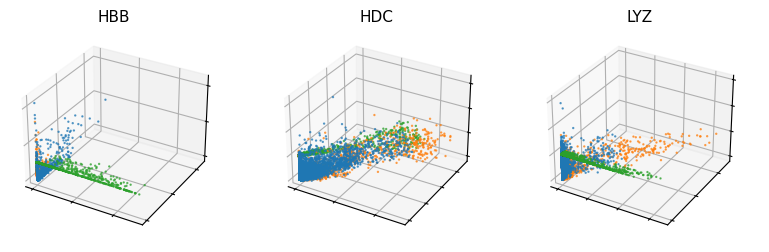

In [32]:
vv.scatter_plot(adata, adata_atac, genes=['HBB', 'HDC', 'LYZ'], by='cus', modalities_pred=['Mc', 'Mu', 'Ms'], color_by='batch', n_cols=3, show_pred_only=True, frame_on=True, axis_on=False, pointsize=0.5)

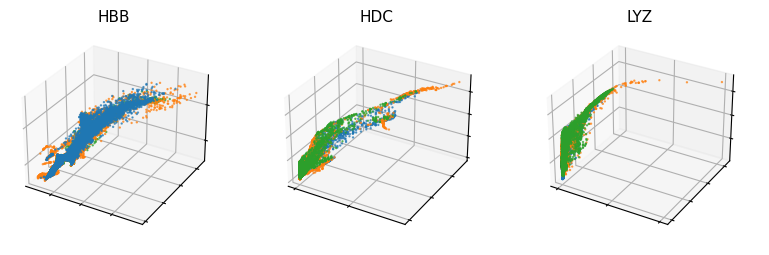

In [33]:
vv.scatter_plot(adata, adata_atac, genes=['HBB', 'HDC', 'LYZ'], by='cus', modalities=[f'{key}_chat', f'{key}_uhat', f'{key}_shat'], color_by='batch', n_cols=3, show_pred_only=True, frame_on=True, axis_on=False, pointsize=0.5)

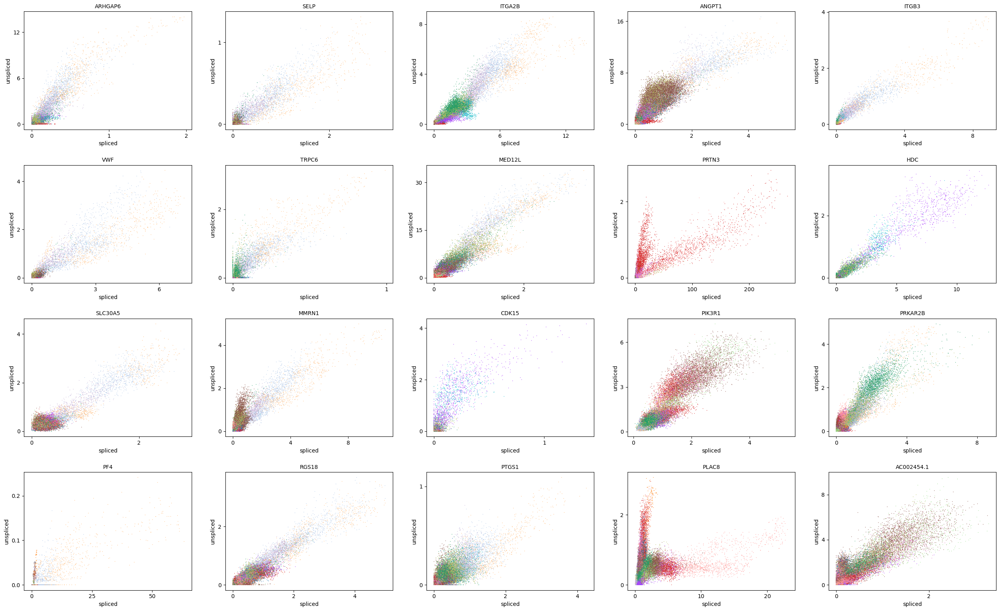

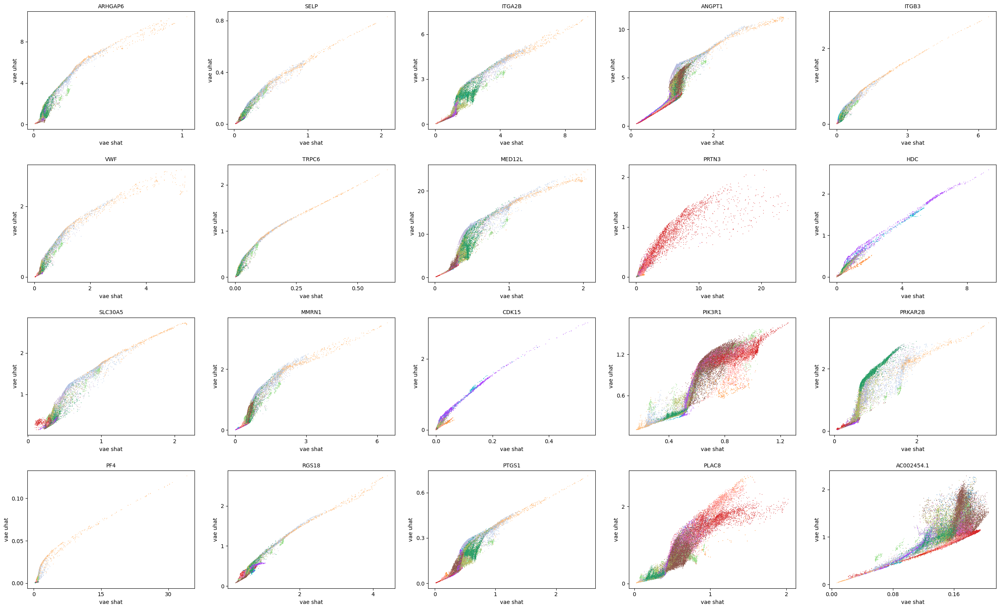

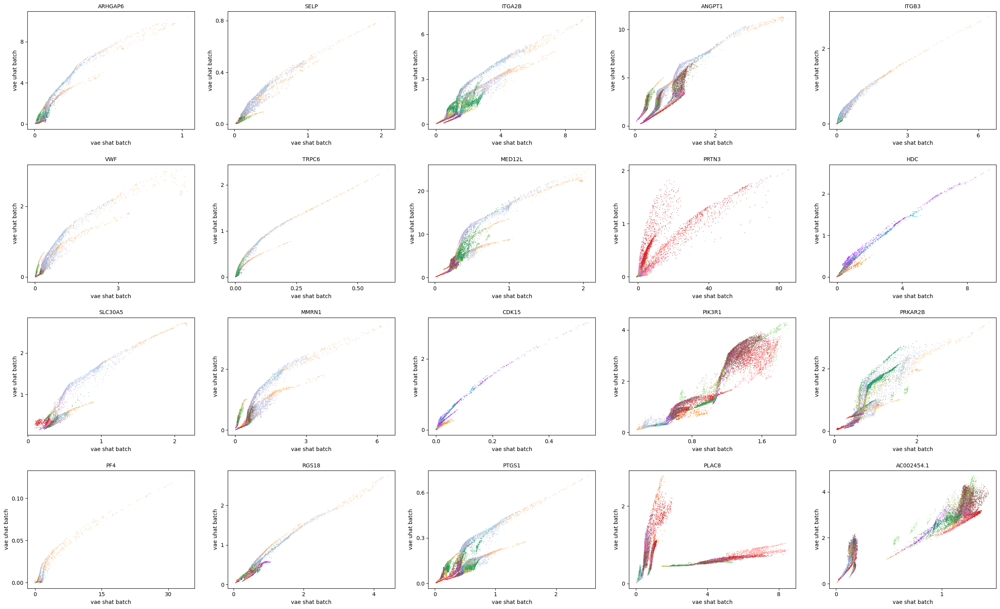

In [34]:
scv.pl.scatter(adata, basis=top_genes[:20], color='leiden', ncols=5)
scv.pl.scatter(adata, basis=top_genes[:20], x=f'{key}_shat', y=f'{key}_uhat', color='leiden', ncols=5)
scv.pl.scatter(adata, basis=top_genes[:20], x=f'{key}_shat_batch', y=f'{key}_uhat_batch', color='leiden', ncols=5)

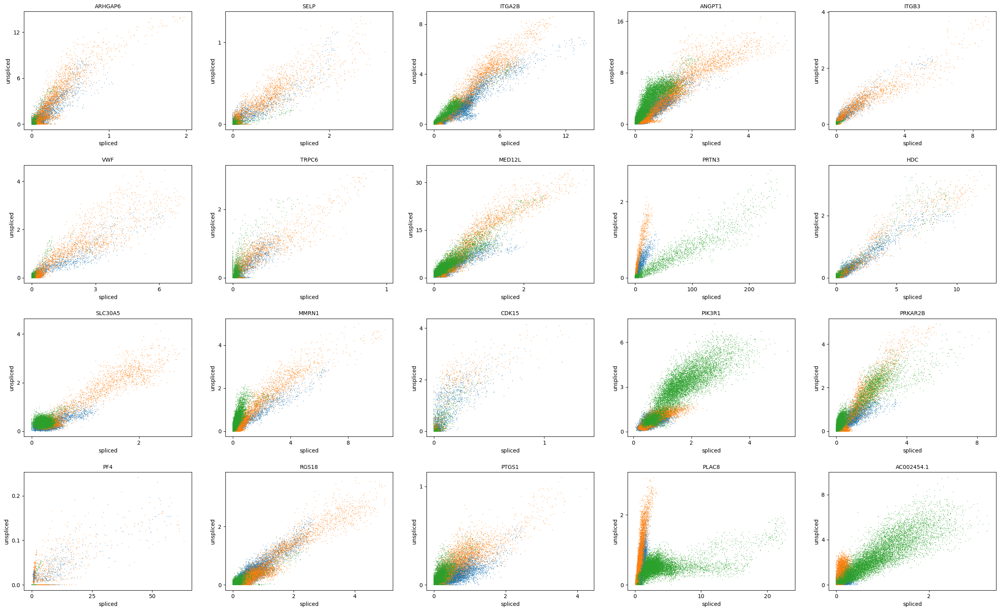

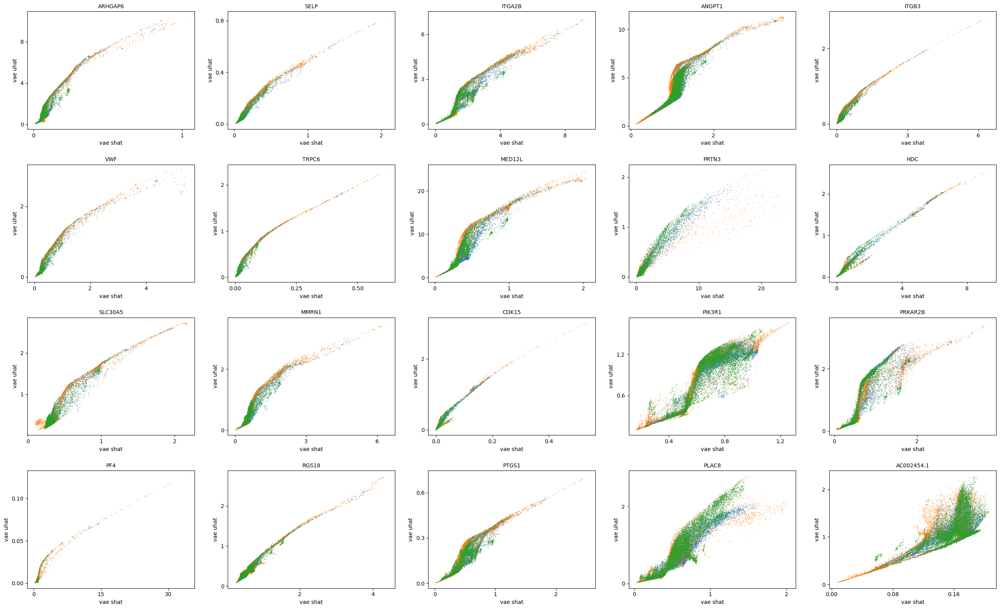

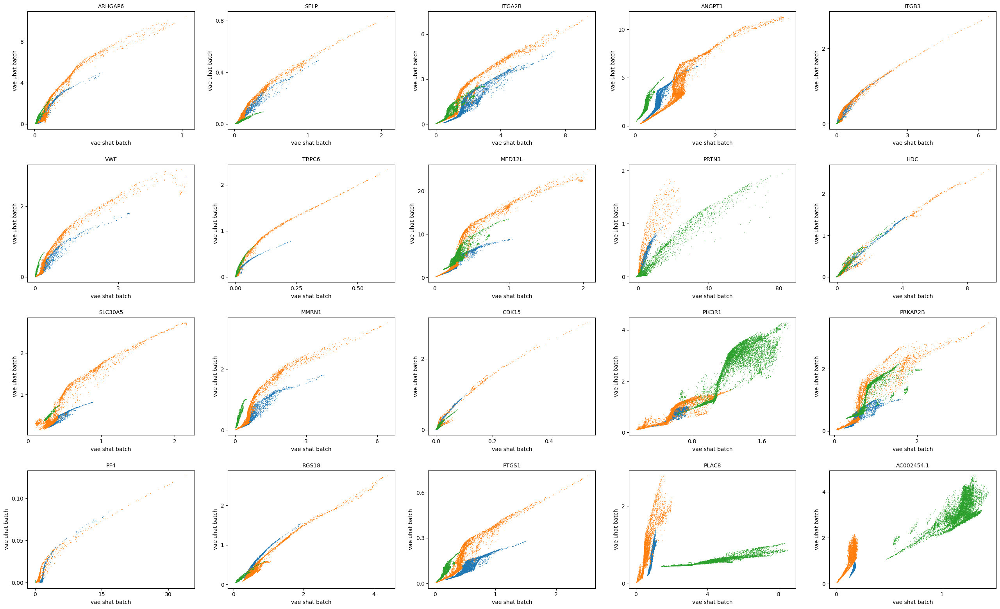

In [35]:
scv.pl.scatter(adata, basis=top_genes[:20], color='batch', ncols=5)
scv.pl.scatter(adata, basis=top_genes[:20], x=f'{key}_shat', y=f'{key}_uhat', color='batch', ncols=5)
scv.pl.scatter(adata, basis=top_genes[:20], x=f'{key}_shat_batch', y=f'{key}_uhat_batch', color='batch', ncols=5)

In [36]:
z = adata.obsm[f'{key}_z']
pca = PCA(n_components=9, random_state=42)
z_pca = pca.fit_transform(z)
adata.obsm['X_z_pca'] = z_pca

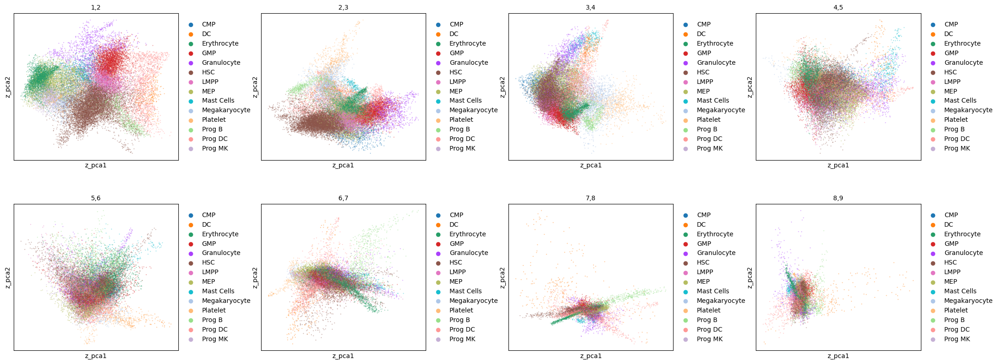

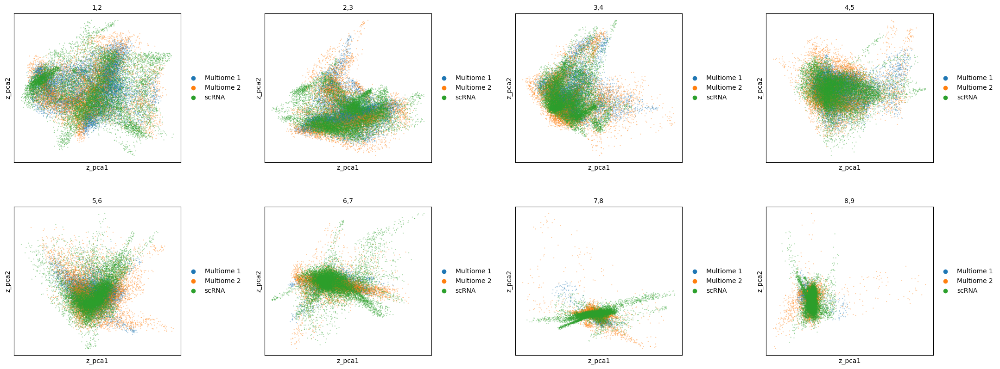

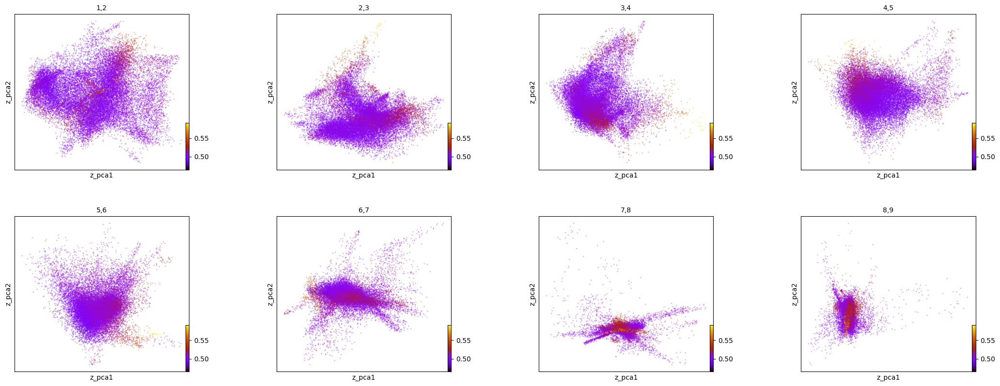

In [37]:
scv.pl.scatter(adata, basis='z_pca', color='leiden', legend_loc='right', color_map='gnuplot', ncols=4, size=10, alpha=0.4, frameon=True, wspace=0.5,
               components=['1,2', '2,3', '3,4', '4,5', '5,6', '6,7', '7,8', '8,9'], title=['1,2', '2,3', '3,4', '4,5', '5,6', '6,7', '7,8', '8,9'])
scv.pl.scatter(adata, basis='z_pca', color='batch', legend_loc='right', color_map='gnuplot', ncols=4, size=10, alpha=0.4, frameon=True, wspace=0.5,
               components=['1,2', '2,3', '3,4', '4,5', '5,6', '6,7', '7,8', '8,9'], title=['1,2', '2,3', '3,4', '4,5', '5,6', '6,7', '7,8', '8,9'])
scv.pl.scatter(adata, basis='z_pca', color=f'{key}_time', legend_loc='right', color_map='gnuplot', ncols=4, size=10, alpha=0.4, frameon=True, wspace=0.5,
               components=['1,2', '2,3', '3,4', '4,5', '5,6', '6,7', '7,8', '8,9'], title=['1,2', '2,3', '3,4', '4,5', '5,6', '6,7', '7,8', '8,9'])

In [38]:
'SPI1' in adata.var_names, 'GATA1' in adata.var_names

(True, True)

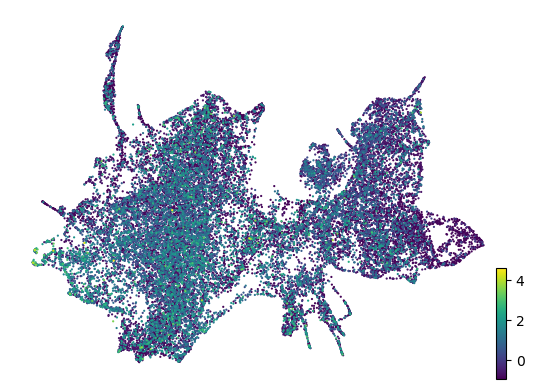

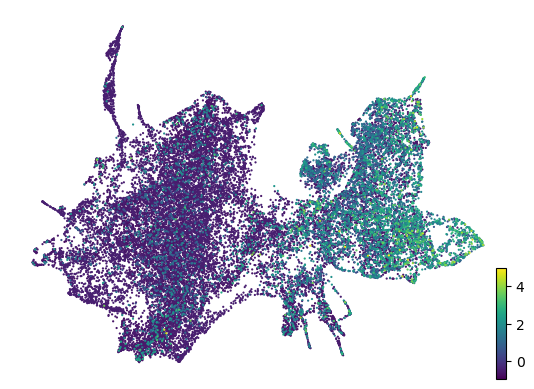

In [39]:
scv.pl.scatter(adata, color='SPI1', basis='z_umap', size=10, title='')
scv.pl.scatter(adata, color='GATA1', basis='z_umap', size=10, title='')

In [40]:
c1 = adata_atac.layers['Mc'].copy()
u1 = adata.layers['Mu'].copy()
s1 = adata.layers['Ms'].copy()
c2 = adata_atac.layers['Mc'].copy()
u2 = adata.layers['Mu'].copy()
s2 = adata.layers['Ms'].copy()

In [41]:
c1[:, np.where(adata.var_names == 'SPI1')[0][0]] = 0
u1[:, np.where(adata.var_names == 'SPI1')[0][0]] = 0
s1[:, np.where(adata.var_names == 'SPI1')[0][0]] = 0
c2[:, np.where(adata.var_names == 'GATA1')[0][0]] = 0
u2[:, np.where(adata.var_names == 'GATA1')[0][0]] = 0
s2[:, np.where(adata.var_names == 'GATA1')[0][0]] = 0

In [42]:
spi1_ko_set = model.prepare_dataset(c1, u1, s1, only_full=True)
gata1_ko_set = model.prepare_dataset(c2, u2, s2, only_full=True)

In [43]:
out1 = model.test(spi1_ko_set, covar=model.var_to_regress.detach().cpu().numpy())
chat1, uhat1, shat1, _, _, _, z1, std_z1, t1, std_t1, t_1, kc1, rho1 = out1

Using reference batch for latent variable computation.


In [44]:
adata_spi1 = ad.AnnData(np.zeros((adata.n_obs, adata.n_vars*3)), obs=adata.obs)

In [45]:
adata_spi1.uns = adata.uns
adata_spi1.obsm = adata.obsm
adata_spi1.obsp = adata.obsp

In [46]:
norm_c = np.linalg.norm(adata.layers[f'{key}_chat'][:,adata.var[f'{key}_velocity_genes'].values], axis=1).reshape(-1, 1) + 1e-10
norm_u = np.linalg.norm(adata.layers[f'{key}_uhat'][:,adata.var[f'{key}_velocity_genes'].values], axis=1).reshape(-1, 1) + 1e-10
norm_s = np.linalg.norm(adata.layers[f'{key}_shat'][:,adata.var[f'{key}_velocity_genes'].values], axis=1).reshape(-1, 1) + 1e-10

In [47]:
adata_spi1.layers['cus'] = np.concatenate((adata.layers[f'{key}_chat']/norm_c, adata.layers[f'{key}_uhat']/norm_u, adata.layers[f'{key}_shat']/norm_s), 1)
adata_spi1.layers['spi1_velocity'] = np.concatenate((chat1/norm_c, uhat1/norm_u, shat1/norm_s), 1) - adata_spi1.layers['cus']
adata_spi1.var['spi1_velocity_genes'] = np.concatenate((adata.var[f'{key}_velocity_genes'].values, adata.var[f'{key}_velocity_genes'].values, adata.var[f'{key}_velocity_genes'].values))
adata_spi1.uns["spi1_velocity_params"] = {'mode': 'dynamical'}
adata_spi1.obsm['X_z_umap'] = z_umap
vv.model.velocity_graph(adata_spi1, key='spi1', xkey='cus', batch_corrected=True)

computing velocity graph (using 1/8 cores)


  0%|          | 0/27841 [00:00<?, ?cells/s]

    finished (0:03:50) --> added 
    'spi1_velocity_norm_graph', sparse matrix with cosine correlations (adata.uns)


computing velocity embedding
    finished (0:00:04) --> added
    'spi1_velocity_norm_z_umap', embedded velocity vectors (adata.obsm)


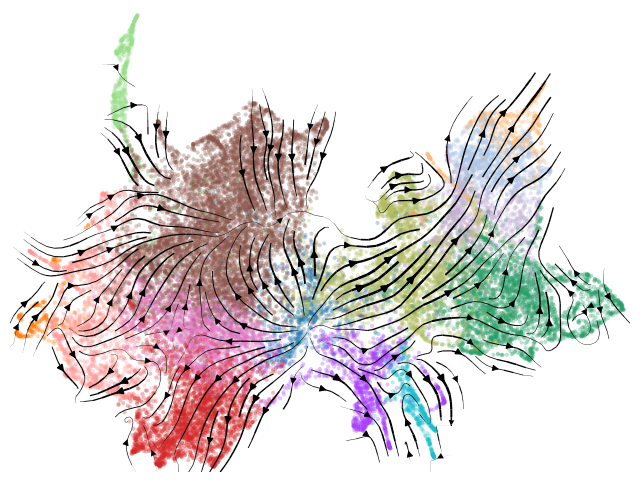

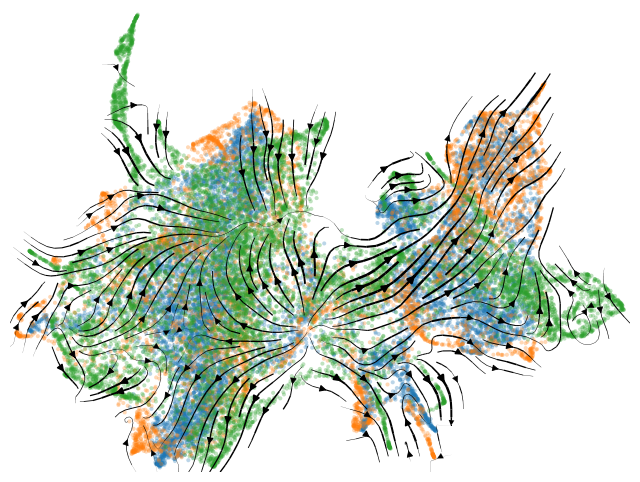

In [48]:
vv.velocity_embedding_stream(adata_spi1, key='spi1', basis='z_umap', color='leiden', title="", figsize=(8,6), legend_loc='none')
vv.velocity_embedding_stream(adata_spi1, key='spi1', basis='z_umap', color='batch', title="", figsize=(8,6), legend_loc='none')

In [49]:
adata.obs['spi1_ko_time_diff'] = np.abs(t_1 - adata.obs[f'{key}_time'])

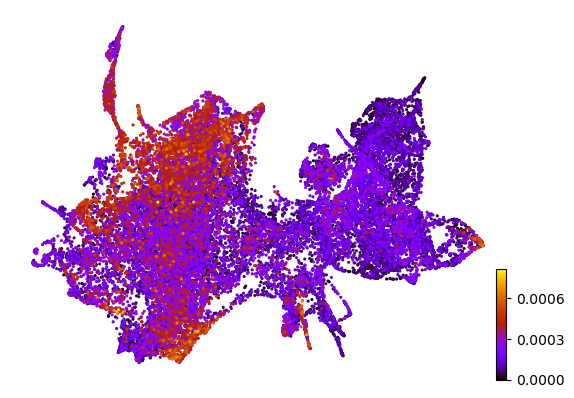

In [50]:
scv.pl.scatter(adata, basis='z_umap', color='spi1_ko_time_diff', legend_loc='right', color_map='gnuplot', size=20, title='')

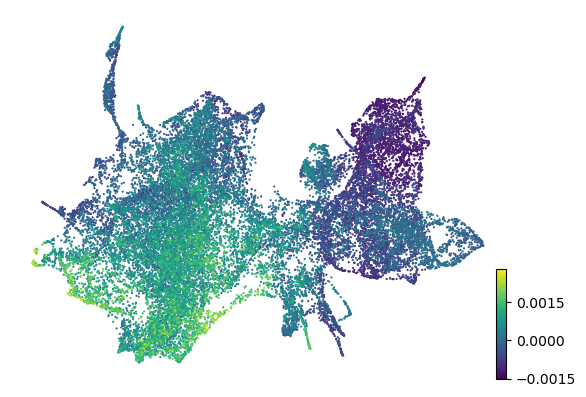

In [51]:
pca = PCA(n_components=1, random_state=42)
z_pca = pca.fit_transform(np.abs(z1-adata.obsm[f'{key}_z']))
adata.obs['z_pca_spi1_ko'] = z_pca
scv.pl.scatter(adata, color='z_pca_spi1_ko', basis='z_umap', size=10, title='')

In [52]:
out2 = model.test(gata1_ko_set, covar=model.var_to_regress.detach().cpu().numpy())
chat2, uhat2, shat2, _, _, _, z2, std_z2, t2, std_t2, t_2, kc2, rho2 = out2

Using reference batch for latent variable computation.


In [53]:
adata_gata1 = ad.AnnData(np.zeros((adata.n_obs, adata.n_vars*3)), obs=adata.obs)

In [54]:
adata_gata1.uns = adata.uns
adata_gata1.obsm = adata.obsm
adata_gata1.obsp = adata.obsp

In [55]:
adata_gata1.layers['cus'] = np.concatenate((adata.layers[f'{key}_chat']/norm_c, adata.layers[f'{key}_uhat']/norm_u, adata.layers[f'{key}_shat']/norm_s), 1)
adata_gata1.layers['gata1_velocity'] = np.concatenate((chat2/norm_c, uhat2/norm_u, shat2/norm_s), 1) - adata_gata1.layers['cus']
adata_gata1.var['gata1_velocity_genes'] = np.concatenate((adata.var[f'{key}_velocity_genes'].values, adata.var[f'{key}_velocity_genes'].values, adata.var[f'{key}_velocity_genes'].values))
adata_gata1.uns["gata1_velocity_params"] = {'mode': 'dynamical'}
adata_gata1.obsm['X_z_umap'] = z_umap
vv.model.velocity_graph(adata_gata1, key='gata1', xkey='cus', batch_corrected=True)

computing velocity graph (using 1/8 cores)


  0%|          | 0/27841 [00:00<?, ?cells/s]

    finished (0:03:52) --> added 
    'gata1_velocity_norm_graph', sparse matrix with cosine correlations (adata.uns)


computing velocity embedding
    finished (0:00:04) --> added
    'gata1_velocity_norm_z_umap', embedded velocity vectors (adata.obsm)


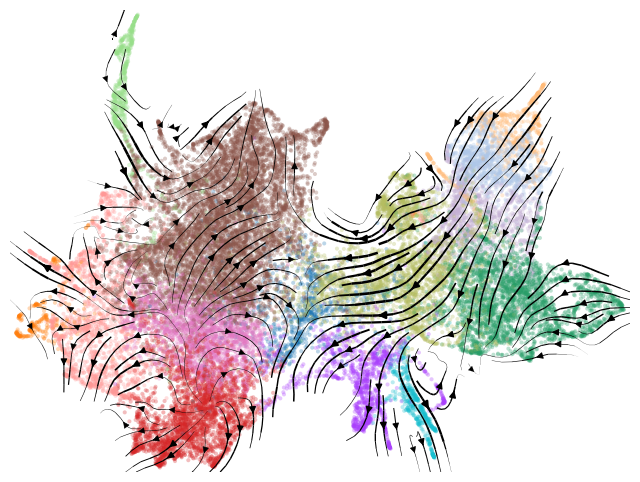

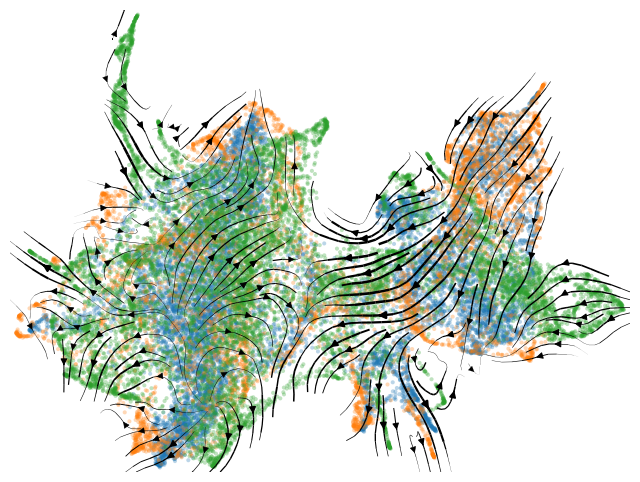

In [56]:
vv.velocity_embedding_stream(adata_gata1, key='gata1', basis='z_umap', color='leiden', title="", figsize=(8,6), legend_loc='none')
vv.velocity_embedding_stream(adata_gata1, key='gata1', basis='z_umap', color='batch', title="", figsize=(8,6), legend_loc='none')

In [57]:
adata.obs['gata1_ko_time_diff'] = np.abs(t_2 - adata.obs[f'{key}_time'])

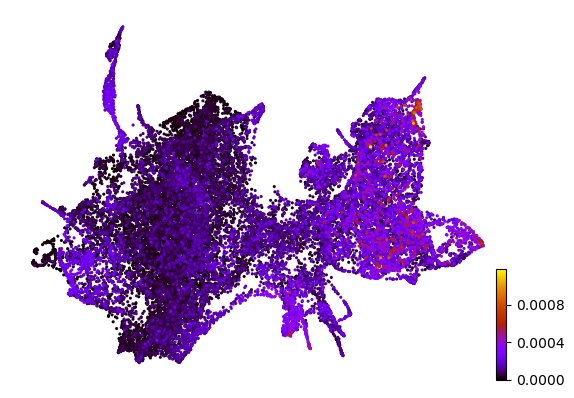

In [58]:
scv.pl.scatter(adata, basis='z_umap', color='gata1_ko_time_diff', legend_loc='right', color_map='gnuplot', size=20, title='')

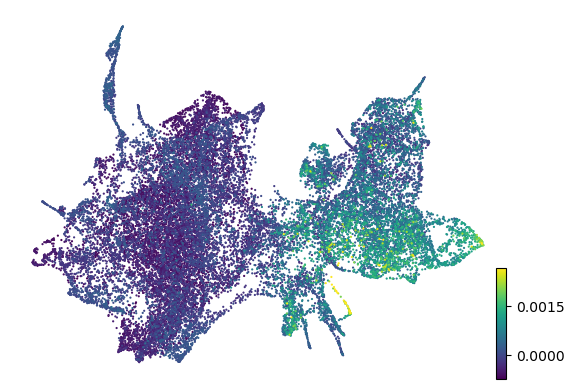

In [59]:
pca = PCA(n_components=1, random_state=42)
z_pca = pca.fit_transform(np.abs(z2-adata.obsm[f'{key}_z']))
adata.obs['z_pca_gata1_ko'] = z_pca
scv.pl.scatter(adata, color='z_pca_gata1_ko', basis='z_umap', size=10, title='', perc=[0,99.9])

In [60]:
adata.write_h5ad(data_path_base+"/final.h5ad")